In [1]:
import csv
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import json
from urllib.request import urlopen
import plotly.express as px
import bokeh
from bokeh.models import ColumnDataSource, RangeTool
from bokeh.palettes import Category20_14
from bokeh.plotting import figure, show
from bokeh.transform import factor_cmap
from bokeh.models import FactorRange
from bokeh.models import Legend
from bokeh.layouts import column
import folium
from folium import plugins
from folium.plugins import HeatMap
from scipy.signal import savgol_filter # for smoothing a curve

# Motor Vehicle Collisions in NYC
* Motivation.
    * What is your dataset?
        * The dataset chosen for this project is the [Motor Vehicle Collision - Crashes](https://data.cityofnewyork.us/Public-Safety/Motor-Vehicle-Collisions-Crashes/h9gi-nx95), where each row is a report of an accident that contains time of crash, vehicle type, number of people injured, and more
    * Why did you choose this/these particular dataset(s)?
        * The reason we chose this dataset is because it would be interesting to investigate the areas in NYC where there is a higher concentration of collisions
    * What was your goal for the end user's experience?
        * To convey where there is a higher concentrations of collisions in NYC, and what could contribute to those concentrations.
       
       
## Basic Stats about the dataset
The dataset contains 1.99 million entries about collisions in NYC but as we can see below, many values are NaN and therefore unusable. There are some columns that we are not interested in investigating, so we can disregard these and ensure that the columns we want do not contain NaN values. By dropping the rows that contain NaN values in important columns, the dataset drops from 1.99 million entries to 1.32 million entries.

In [2]:
data = pd.read_csv("Motor_Vehicle_Collisions_-_Crashes.csv")
type1 = "VEHICLE TYPE CODE 1"
cause1 = 'CONTRIBUTING FACTOR VEHICLE 1'
data.head()

C:\Users\tobia\Anaconda3\envs\imanalysis\lib\site-packages\IPython\core\interactiveshell.py:3457: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
0,09/11/2021,2:39,NaN,NaN,NaN,NaN,NaN,WHITESTONE EXPRESSWAY,20 AVENUE,NaN,...,Unspecified,NaN,NaN,NaN,4455765,Sedan,Sedan,NaN,NaN,NaN
1,03/26/2022,11:45,NaN,NaN,NaN,NaN,NaN,QUEENSBORO BRIDGE UPPER,NaN,NaN,...,NaN,NaN,NaN,NaN,4513547,Sedan,NaN,NaN,NaN,NaN
2,06/29/2022,6:55,NaN,NaN,NaN,NaN,NaN,THROGS NECK BRIDGE,NaN,NaN,...,Unspecified,NaN,NaN,NaN,4541903,Sedan,Pick-up Truck,NaN,NaN,NaN
3,09/11/2021,9:35,BROOKLYN,11208.0,40.667202,-73.866500,"(40.667202, -73.8665)",NaN,NaN,1211 LORING AVENUE,...,NaN,NaN,NaN,NaN,4456314,Sedan,NaN,NaN,NaN,NaN
4,12/14/2021,8:13,BROOKLYN,11233.0,40.683304,-73.917274,"(40.683304, -73.917274)",SARATOGA AVENUE,DECATUR STREET,NaN,...,NaN,NaN,NaN,NaN,4486609,NaN,NaN,NaN,NaN,NaN


In [3]:
data['Date'] = pd.to_datetime(data['CRASH DATE'])
data['year'] = pd.DatetimeIndex(data['Date']).year
data['month'] = pd.DatetimeIndex(data['Date']).month
data['day'] = pd.DatetimeIndex(data['Date']).day
data['weekday'] = pd.DatetimeIndex(data['Date']).weekday

In [4]:
data.columns.unique()

Index(['CRASH DATE', 'CRASH TIME', 'BOROUGH', 'ZIP CODE', 'LATITUDE',
       'LONGITUDE', 'LOCATION', 'ON STREET NAME', 'CROSS STREET NAME',
       'OFF STREET NAME', 'NUMBER OF PERSONS INJURED',
       'NUMBER OF PERSONS KILLED', 'NUMBER OF PEDESTRIANS INJURED',
       'NUMBER OF PEDESTRIANS KILLED', 'NUMBER OF CYCLIST INJURED',
       'NUMBER OF CYCLIST KILLED', 'NUMBER OF MOTORIST INJURED',
       'NUMBER OF MOTORIST KILLED', 'CONTRIBUTING FACTOR VEHICLE 1',
       'CONTRIBUTING FACTOR VEHICLE 2', 'CONTRIBUTING FACTOR VEHICLE 3',
       'CONTRIBUTING FACTOR VEHICLE 4', 'CONTRIBUTING FACTOR VEHICLE 5',
       'COLLISION_ID', 'VEHICLE TYPE CODE 1', 'VEHICLE TYPE CODE 2',
       'VEHICLE TYPE CODE 3', 'VEHICLE TYPE CODE 4', 'VEHICLE TYPE CODE 5',
       'Date', 'year', 'month', 'day', 'weekday'],
      dtype='object')

In [5]:
print(f"Length of dataset before: {len(data.index)}")
data = data.dropna(subset=['CRASH DATE', 'CRASH TIME', 'BOROUGH', 'LATITUDE',
       'LONGITUDE','VEHICLE TYPE CODE 1', 'CONTRIBUTING FACTOR VEHICLE 1'])
print(f"Length of dataset after: {len(data.index)}")

Length of dataset before: 1985365
Length of dataset after: 1321585


First of all, we will look into the amount of data available per year, in order to see if there are any issues we need to address. Immediately we can see that 2023 is also included, since the dataset is frequently updated, but we likely need to exclude this year as it is not complete.

<AxesSubplot:title={'center':'Motor Vehicle Crashes per year'}, xlabel='Year', ylabel='Crashes'>

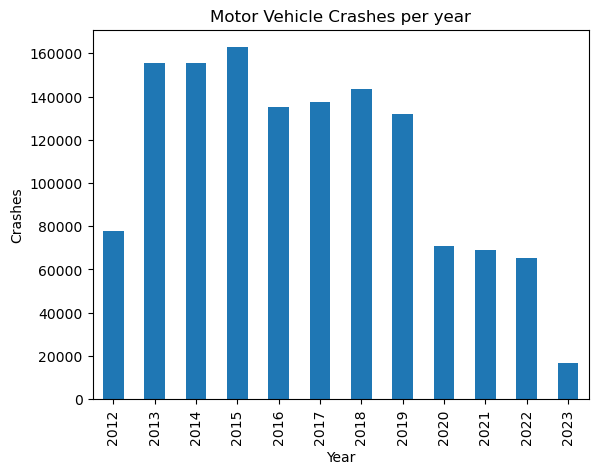

In [6]:
df_year = data.groupby("year").size()
df_year.plot(kind='bar',
            title="Motor Vehicle Crashes per year",
                  xlabel = "Year", ylabel = "Crashes")

Another thing to note is that 2012 is lower than the subsequent years, and as we can see below that is due to there not being any data from before July. Since this is also incomplete, we will also exclude 2012.

<AxesSubplot:title={'center':'Motor Vehicle Crashes per month in 2012'}, xlabel='Month', ylabel='Crashes'>

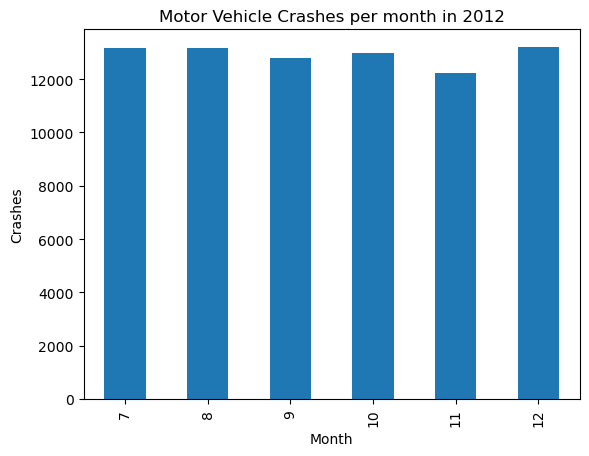

In [7]:
df_2012 = data[data.year == 2012].groupby("month").size()
df_2012.plot(kind='bar',
            title="Motor Vehicle Crashes per month in 2012",
                  xlabel = "Month", ylabel = "Crashes")

In [8]:
data = data.loc[(data["year"] > 2012) | (data["year"] < 2023)]
data['year'].unique()

array([2021, 2022, 2019, 2016, 2020, 2012, 2018, 2017, 2015, 2023, 2014,
       2013], dtype=int64)

Another issue that needs to be addressed is the amount of repeating classifications of vehicle types. Many vehicle types are sometimes reported using abbreviations, non-standard capitalization or simply with typos, resulting in the same vehicle type being spread out across many different types. Using "Ambulance" as an example, it is reported as "AMB", "AMBU", "AMBULANCE", "AMbul", "Ambu", "ambulance", and many more. While in most cases a single wrong report will not matter for the total amount of entries, in other cases the amount will increase significantly. We will therefore prune the dataset so that some entries are merged together, and erroneous entries will be disregarded.

In [9]:
counts = data.groupby("VEHICLE TYPE CODE 1").size().reset_index()
for index, row in counts.iterrows():
    print(f"Vehicle: {row['VEHICLE TYPE CODE 1']:<16}| count: {row[0]}")

Vehicle: 0               | count: 1
Vehicle: 1               | count: 2
Vehicle: 11111           | count: 1
Vehicle: 12 PA           | count: 1
Vehicle: 12 PASSENG      | count: 1
Vehicle: 12 Pa           | count: 1
Vehicle: 12 passage      | count: 1
Vehicle: 15 Pa           | count: 1
Vehicle: 18 WH           | count: 1
Vehicle: 18 WHEELER      | count: 1
Vehicle: 197209          | count: 1
Vehicle: 1S              | count: 1
Vehicle: 2 DOO           | count: 1
Vehicle: 2 DR            | count: 1
Vehicle: 2 TON           | count: 1
Vehicle: 2 WHE           | count: 1
Vehicle: 2 dr sedan      | count: 1305
Vehicle: 2- to           | count: 1
Vehicle: 2000            | count: 1
Vehicle: 250-3           | count: 1
Vehicle: 26 ft           | count: 1
Vehicle: 3 WHE           | count: 2
Vehicle: 3 Whe           | count: 1
Vehicle: 3 doo           | count: 1
Vehicle: 3-Door          | count: 178
Vehicle: 315 e           | count: 1
Vehicle: 35 FT           | count: 1
Vehicle: 3DC-          

We will sort the dataset based on the amount of entries that there are, and then plot the resulting dataset. When we do so, we can see that there is an overrepresentation of sedans, SUVs and "passenger vehicles" which we assume is a generalization of many different vehicles. This will also make attempts to plot based on vehicle types harder, since certain types may not have enough data.

<AxesSubplot:title={'center':'Accident Occurences by Category'}, xlabel='Categories', ylabel='Num. of Incidents'>

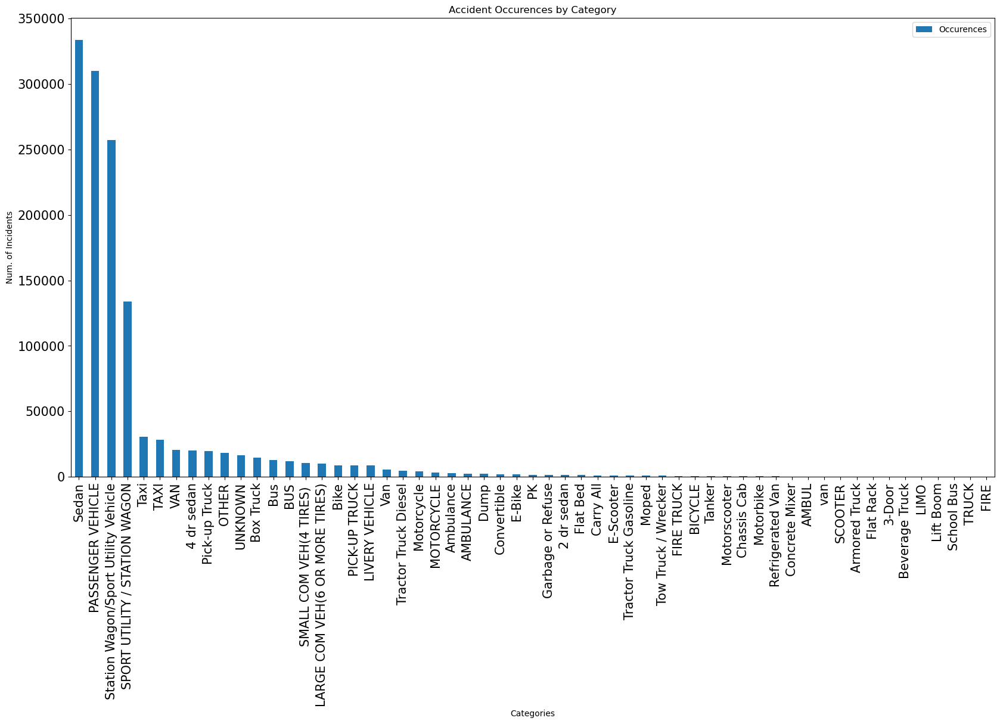

In [10]:
plotdata = pd.DataFrame(
    {"Occurences": data["VEHICLE TYPE CODE 1"].value_counts()}, 
    index=data["VEHICLE TYPE CODE 1"].unique())

plotdata.sort_values(by='Occurences', inplace = True, ascending=False) 
#print(plotdata["Occurences"].unique())
plotdata = plotdata.loc[plotdata["Occurences"] > 100]
plotdata.plot(kind="bar",
              figsize=(20, 10), 
              title="Accident Occurences by Category",
             xlabel = "Categories", ylabel = "Num. of Incidents",
             fontsize = 15)

Based on the values given here, we will now combine entries into similar types

In [11]:
data = data.replace(to_replace=["4 dr sedan", "2 dr sedan", '3-Door'], value='Sedan')
data = data.replace(to_replace=['Station Wagon/Sport Utility Vehicle', 'SPORT UTILITY / STATION WAGON'], value='SUV')
data = data.replace(to_replace='TAXI', value='Taxi')
data = data.replace(to_replace=['VAN', 'van', 'Refrigerated Van'], value='Van')
data = data.replace(to_replace=['PICK-UP TRUCK', 'PK'], value='Pick-up Truck')
data = data.replace(to_replace=['FIRE', 'FIRE TRUCK'], value='Fire Truck')
data = data.replace(to_replace=['AMBUL', 'AMBULANCE'], value='Ambulance')
data = data.replace(to_replace=['BICYCLE'], value='Bike')
data = data.replace(to_replace=['BUS'], value='Bus')
data = data.replace(to_replace=['Dump', 'Garbage or Refuse'], value='Garbage Truck')
data = data.replace(to_replace=['Tractor Truck Diesel', 'Tractor Truck Gasoline', 'TRUCK','Tanker' ,'LARGE COM VEH(6 OR MORE TIRES)'], value='Transport Truck')
data = data.replace(to_replace=['MOTORCYCLE', 'Motorbike'], value='Motorcycle')
data = data.replace(to_replace=['Motorscooter', 'SCOOTER'], value='Scooter')

<AxesSubplot:title={'center':'Accidents by Vehicle Types'}, xlabel='Vehicle Type', ylabel='Num. of Collisions'>

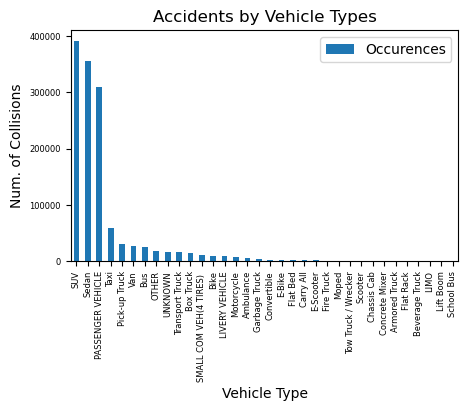

In [12]:
plotdata_filtered = pd.DataFrame(
    {"Occurences": data["VEHICLE TYPE CODE 1"].value_counts()}, 
    index=data["VEHICLE TYPE CODE 1"].unique())
plotdata_filtered.sort_values(by='Occurences', inplace = True, ascending=False) 
#print(plotdata["Occurences"].unique())
plotdata_filtered = plotdata_filtered.loc[plotdata_filtered["Occurences"] > 100]
plotdata_filtered.plot(kind="bar",
              figsize=(5, 3), 
              title="Accidents by Vehicle Types",
             xlabel = "Vehicle Type", ylabel = "Num. of Collisions",
             fontsize = 6)

In [13]:
plotdata_filtered

,Occurences
SUV,390948
Sedan,355477
PASSENGER VEHICLE,309830
Taxi,58663
Pick-up Truck,29696
Van,26559
Bus,24766
OTHER,18069
UNKNOWN,16260
Transport Truck,15798


We can see that by combining certain types into others we increase the amount of representation for each vehicle while reducing the amount of vehicle types that need to be kept track of. However, we can see that the amount of entries for underrepresented types is significantly lower than those that contain many entries. This is especially apparent when we plot the same graph using a logarithmic plot.

<AxesSubplot:title={'center':'Crash Incidents by Type (Log)'}, xlabel='Vehicle Type', ylabel='Num. of Incidents'>

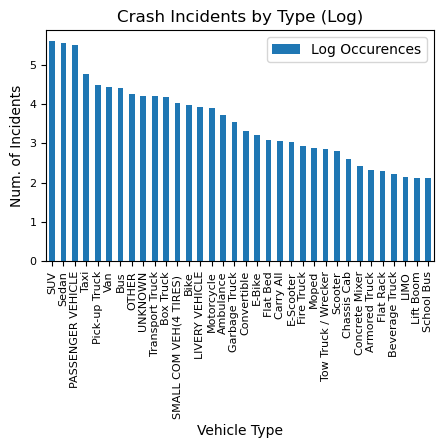

In [25]:
plotdata_log = pd.DataFrame(
    {"Log Occurences": np.log10(plotdata_filtered['Occurences'])}, 
    index=plotdata_filtered.index.unique())

plotdata_log.sort_values(by='Log Occurences', inplace = True, ascending=False)
plotdata_log.plot(kind="bar",
              figsize=(5, 3), 
              title="Crash Incidents by Type (Log)",
             xlabel = "Vehicle Type", ylabel = "Num. of Incidents",
             fontsize = 8)

Here we can see that the underrepresented vehicle types have between 100 and 1000 entries, while the most common have upwards of 100.000 entries. We will therefore focus on the most common types so that we enough data for the types we want to investigate, and we will select the 11 most common types as our focus types, disregarding types with unspecific information like 'Passenger Vehicle'.

In [15]:
focusvehicles = ['SUV', 'Sedan', 'Taxi', 'Pick-up Truck', 'Van', 'Bus', 'Transport Truck', 'Box Truck', 'Bike', 'Motorcycle', 'Ambulance']
len(focusvehicles)

11

# Data analysis
For the data analysis we used the techniques that we learned throughout the course, and mostly focused on the tools that included location and wanted to focus on where the accidents happen. We decided that analysis based on time would not work as well, since initial analysis showed no temporal patterns in the data that we thought were worth investigating further. One interesting thing that we saw when the accidents were plotted over the years was a sharp decline in accidents during the period 2020-2022. This could possibly be due to the COVID-19 pandemic that put many countries all across the world in lockdown. As the United States were one of the countries that were hit hardest in the world, it is likely the cause of the reduction.(See [NYC Covid Timeline](https://www.nytimes.com/interactive/2022/nyregion/nyc-covid-timeline.html) from nytimes.com)

In order to do the location based analysis, we decided to use histogram plots over the latitude and longitude. While we cannot use this to see where there are large concentrations of accidents in NYC, we can use it to investigate whether the accidents happen in the same places or not. If there are similar peaks it will indicate that the collisions happen in the same place, and that seems to be the case for most of the focus vehicles. Most of them have a peak around 40.75 Lat and -74 Lon, and especially Taxi vehicles seem to be concentrated around this point. The more common vehicle types such as Sedans and SUVs are more spread out, but this is likely also due to the much higher amount of reported cases.

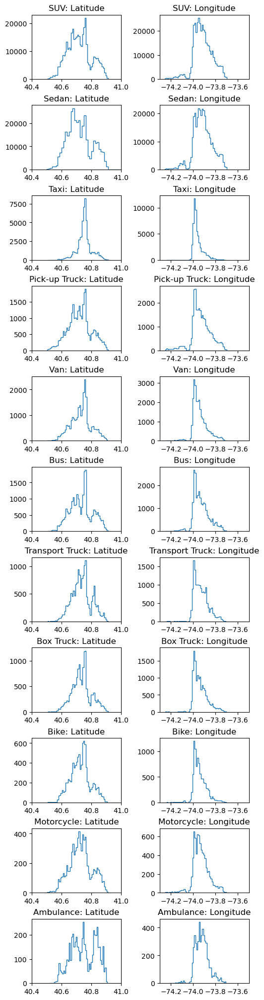

In [26]:
fig, ax = plt.subplots(11, 2, figsize=(5,20), layout="constrained")
for idx, vehicle in enumerate(focusvehicles):
    hist_data = data.loc[(data[type1] == vehicle) & (data['LATITUDE'] > 0) & data['LONGITUDE'] > 0]
    
    ax[idx, 0].set_title(f'{vehicle}: Latitude')
    ax[idx, 0].set_xlim(40.4, 41)
    hist, bin_edges = np.histogram(hist_data['LATITUDE'], bins = 50)
    ax[idx, 0].stairs(hist, bin_edges)
    

    ax[idx, 1].set_title(f'{vehicle}: Longitude')
    ax[idx, 1].set_xlim(-74.3, -73.5)
    hist, bin_edges = np.histogram(hist_data['LONGITUDE'], bins = 50)
    ax[idx, 1].stairs(hist, bin_edges)

plt.show()

Now we used Folium to create heatmaps over some of these vehicle types to get a better idea of where these accidents happen. Since it would be cumbersome to do so for all 11 vehicles, we will instead focus on Sedans, SUVs and Taxis. The last one in particular we chose considering it is very concentrated around a single point and not spread out across NYC like the others.

With these heatmaps, we can see that there is a large concentration of collisions on Manhatten Island across all three vehicle types. Since this is where the taxi collisions also occur, we now know this where a majority of collisions occur.

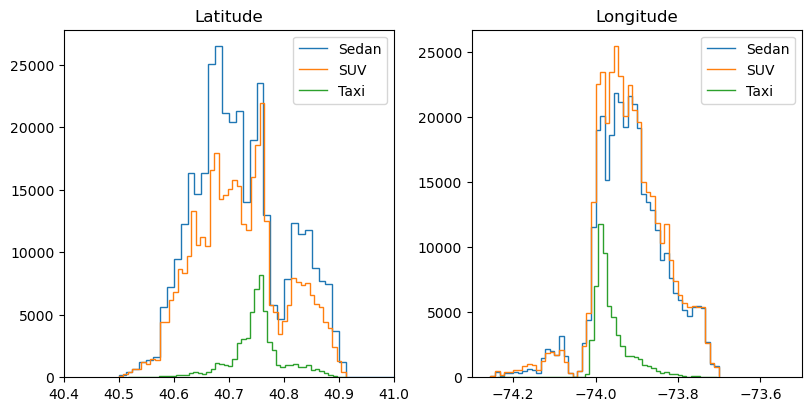

In [17]:
fig, ax = plt.subplots(1, 2, figsize=(8,4), layout="constrained")
ax[0].set_xlim(40.4, 41)
ax[1].set_xlim(-74.3, -73.5)

for idx, vehicle in enumerate(["Sedan", "SUV", "Taxi"]):
    hist_data = data.loc[(data[type1] == vehicle) & (data['LATITUDE'] > 0) & data['LONGITUDE'] > 0]
    
    ax[0].set_title(f'Latitude')
    hist, bin_edges = np.histogram(hist_data['LATITUDE'], bins = 50)
    ax[0].stairs(hist, bin_edges)

    ax[1].set_title(f'Longitude')
    hist, bin_edges = np.histogram(hist_data['LONGITUDE'], bins = 50)
    ax[1].stairs(hist, bin_edges)
  
ax[0].legend(["Sedan", "SUV", "Taxi"])
ax[1].legend(["Sedan", "SUV", "Taxi"])

plt.show()

In [18]:
lat, lon = 40.701711, -73.935242 # Coordinates for NYC

sorted_df = data.loc[(data[type1] == 'Sedan')]
sorted_df['LONGITUDE'] = sorted_df['LONGITUDE'].astype(float)
sorted_df['LATITUDE'] = sorted_df['LATITUDE'].astype(float)
sorted_df = sorted_df.dropna(axis=0, subset=['LATITUDE','LONGITUDE'])
heat_data = [[row['LATITUDE'],row['LONGITUDE']] for index, row in sorted_df.iterrows()]

map_nyc = folium.Map([lat, lon], tiles = "Stamen Toner", zoom_start=10.5)
folium.GeoJson("https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/new-york-city-boroughs.geojson").add_to(map_nyc)
HeatMap(heat_data, radius=15, min_opacity=0.0, max_opacity=0.8).add_to(map_nyc)
map_nyc.save('map_sedan.html')
map_nyc

C:\Users\tobia\Anaconda3\envs\imanalysis\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
C:\Users\tobia\Anaconda3\envs\imanalysis\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [19]:
sorted_df = data.loc[(data[type1] == 'SUV')]
sorted_df['LONGITUDE'] = sorted_df['LONGITUDE'].astype(float)
sorted_df['LATITUDE'] = sorted_df['LATITUDE'].astype(float)
sorted_df = sorted_df.dropna(axis=0, subset=['LATITUDE','LONGITUDE'])
heat_data = [[row['LATITUDE'],row['LONGITUDE']] for index, row in sorted_df.iterrows()]

map_nyc = folium.Map([lat, lon], tiles = "Stamen Toner", zoom_start=10.5)
folium.GeoJson("https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/new-york-city-boroughs.geojson").add_to(map_nyc)
HeatMap(heat_data, name="SUV", min_opacity=0.0, max_opacity=0.8, radius=15).add_to(map_nyc)
map_nyc.save('map_suv.html')
map_nyc

C:\Users\tobia\Anaconda3\envs\imanalysis\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\tobia\Anaconda3\envs\imanalysis\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [20]:
sorted_df = data.loc[(data[type1] == 'Taxi')]
sorted_df['LONGITUDE'] = sorted_df['LONGITUDE'].astype(float)
sorted_df['LATITUDE'] = sorted_df['LATITUDE'].astype(float)
sorted_df = sorted_df.dropna(axis=0, subset=['LATITUDE','LONGITUDE'])
heat_data = [[row['LATITUDE'],row['LONGITUDE']] for index, row in sorted_df.iterrows()]

map_nyc = folium.Map([lat, lon], tiles = "Stamen Toner", zoom_start=10.5)
folium.GeoJson("https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/new-york-city-boroughs.geojson").add_to(map_nyc)
HeatMap(heat_data, radius=15, min_opacity=0.0, max_opacity=0.8).add_to(map_nyc)
map_nyc.save('map_taxi.html')
map_nyc

C:\Users\tobia\Anaconda3\envs\imanalysis\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\tobia\Anaconda3\envs\imanalysis\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


## Interactive Plot
We will now investigate the three most common vehicle types and their occurences over time, and we will do in an interactive way. Using the `bokeh` python package, we can make plots that the user can interact with. The type of plot that we will use is a fairly simple version, being a scroller where you can see the amount of collisions per week, and drag the timeframe that you want to view. We will for all three vehicle types also include a smoothed curve using a *Savgol filter*, which will make it much easier to identify the trends

In [21]:
data['Date'] = pd.to_datetime(data['Date']) - pd.to_timedelta(7, unit='d')
df_sedan = data.loc[(data[type1] == "Sedan")]
df_suv = data.loc[(data[type1] == "SUV")]
df_taxi = data.loc[(data[type1] == "Taxi")]

data_sedan = df_sedan.groupby([pd.Grouper(key='Date', freq='W')]).size().reset_index(name='counts')
data_suv = df_suv.groupby([pd.Grouper(key='Date', freq='W')]).size().reset_index(name='counts')
data_taxi = df_taxi.groupby([pd.Grouper(key='Date', freq='W')]).size().reset_index(name='counts')

data_sedan_smooth = pd.DataFrame(savgol_filter(data_sedan['counts'], 101, 3))
data_sedan_smooth['Date'] = data_sedan['Date'].to_list()
data_sedan_smooth.columns = ['counts', 'Date']

data_suv_smooth = pd.DataFrame(savgol_filter(data_suv['counts'], 101, 3))
data_suv_smooth['Date'] = data_suv['Date'].to_list()
data_suv_smooth.columns = ['counts', 'Date']

data_taxi_smooth = pd.DataFrame(savgol_filter(data_taxi['counts'], 101, 3))
data_taxi_smooth['Date'] = data_taxi['Date'].to_list()
data_taxi_smooth.columns = ['counts', 'Date']


In [22]:
source = ColumnDataSource(data=data_sedan)
source_smooth = ColumnDataSource(data=data_sedan_smooth)
dates = np.array(data_sedan['Date'], dtype=np.datetime64)

p = figure(title=f"Collisions per week: Sedan", height=150, width=300, tools="xpan", toolbar_location=None,
           x_axis_type="datetime", x_axis_location="above",
           background_fill_color="#efefef", x_range=(dates[0], dates[150]))

p.line('Date', 'counts', source=source)
p.line('Date', 'counts', source=source_smooth, line_color="#f46d43", line_width=3)
p.yaxis.axis_label = 'Crime counts'

select = figure(title="Drag the middle and edges of the \nselection box to change \nthe range above",
                height=125, width=300, y_range=p.y_range, 
                x_axis_type="datetime", y_axis_type=None,
                tools="", toolbar_location=None, background_fill_color="#efefef")

range_tool = RangeTool(x_range=p.x_range)
range_tool.overlay.fill_color = "navy"
range_tool.overlay.fill_alpha = 0.2

select.line('Date', 'counts', source=source)
select.ygrid.grid_line_color = None
select.add_tools(range_tool)

show(column(p, select))

In [23]:
source = ColumnDataSource(data=data_suv)
source_smooth = ColumnDataSource(data=data_suv_smooth)
dates = np.array(data_sedan['Date'], dtype=np.datetime64)

p = figure(title=f"Collisions per week: SUV", height=150, width=300, tools="xpan", toolbar_location=None,
           x_axis_type="datetime", x_axis_location="above",
           background_fill_color="#efefef", x_range=(dates[0], dates[150]))

p.line('Date', 'counts', source=source)
p.line('Date', 'counts', source=source_smooth, line_color="#f46d43", line_width=3)
p.yaxis.axis_label = 'Crime counts'

select = figure(title="Drag the middle and edges of the \nselection box to change \nthe range above",
                height=125, width=300, y_range=p.y_range, 
                x_axis_type="datetime", y_axis_type=None,
                tools="", toolbar_location=None, background_fill_color="#efefef")

range_tool = RangeTool(x_range=p.x_range)
range_tool.overlay.fill_color = "navy"
range_tool.overlay.fill_alpha = 0.2

select.line('Date', 'counts', source=source)
select.ygrid.grid_line_color = None
select.add_tools(range_tool)

show(column(p, select))

In [24]:
source = ColumnDataSource(data=data_taxi)
source_smooth = ColumnDataSource(data=data_taxi_smooth)
dates = np.array(data_sedan['Date'], dtype=np.datetime64)

p = figure(title=f"Collisions per week: Taxi", height=150, width=300, tools="xpan", toolbar_location=None,
           x_axis_type="datetime", x_axis_location="above",
           background_fill_color="#efefef", x_range=(dates[0], dates[150]))

p.line('Date', 'counts', source=source)
p.line('Date', 'counts', source=source_smooth, line_color="#f46d43", line_width=3)
p.yaxis.axis_label = 'Crime counts'

select = figure(title="Drag the middle and edges of the \nselection box to change \nthe range above",
                height=125, width=300, y_range=p.y_range, 
                x_axis_type="datetime", y_axis_type=None,
                tools="", toolbar_location=None, background_fill_color="#efefef")

range_tool = RangeTool(x_range=p.x_range)
range_tool.overlay.fill_color = "navy"
range_tool.overlay.fill_alpha = 0.2

select.line('Date', 'counts', source=source)
select.ygrid.grid_line_color = None
select.add_tools(range_tool)

show(column(p, select))

### What we've learned
We can see that the dataset is very large, and according to the [NYC Open Data](https://data.cityofnewyork.us/Public-Safety/Motor-Vehicle-Collisions-Crashes/h9gi-nx95) it is updated daily. However the entries in it are fairly prone to mistakes, as many of them either contain NaN values or wrongly written vehicle types.

# Genre
For this project we chose to use the *Magazine style* article, since we believe it is a good fit for showing figures and writing text to explain said figures.

* Which tools did you use from each of the 3 categories of Visual Narrative (Figure 7 in Segal and Heer). Why?

The magazine style article lends itself poorly to visual narrative tools described in the paper by Segal and Heer, as it is primarily text accompanied by figures and plots that support the text. We have therefore not used any of the tools mentioned.

* Which tools did you use from each of the 3 categories of Narrative Structure (Figure 7 in Segal and Heer). Why?

From the Ordering category we decided to use the Linear style, as we wanted an article with a clear and focused narrative. Using the Random Access or User Directed Path would not allow for a red thread, and so we chose the red thread.

From the Interactivity category we wanted simple-to-use plots and so the choice to use Very Limited Interactivity was clear. As for the graph itself, we wanted to use bokeh's timeseries plots, which include viewing a specific period. For that reason we also use the Filtering/Selection/Search style in our article

Finally for Messaging, since we wanted to make a traditional article it would be an obvious choice to use Captions/Headlines, Introductory Text and Summary.


# Visualizations
* Explain the visualizations you've chosen.
    * The visualizations that we've chosen for this project are bar charts, histogram charts, heatmaps, and interactive line graphs.
* Why are they right for the story you want to tell?
    * These types of visualizations are suitable for telling stories that deal with location based topics, such as where motor vehicle colliosions happen

# Discussion
* What went well?
    * I think that the visualizations were well made, and we used the Segal and Heer tools in a way that benefitted the article.
* What is still missing? What could be improved?, Why?
    * The project could likely have benefitted from a more well-defined topic as the current one is fairly broad. Additionally, the project only started at the beginning of the *Prep Project Assignment B* period, since a previous group was split and a new topic, i.e this one, was chosen, the project lacked the additional preparation time of Assignment A. Furthermore, the project could also have benefitted from the feedback session of Assignment A, as the video we previously made was for another topic.

# Contributions
This project was made by a one-man group, and there is therefore no need to write percentile contributions.